# Keep-it-dry! Preprocessing
Based on Kaggle: https://www.kaggle.com/code/kevinmorgado/top-20-product-failure-prediction/notebook 

In [13]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.pipeline import make_pipeline
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

## Data Analysis

In [2]:
df_train = pd.read_csv('./../kid_train.csv')

In [32]:
df_test = pd.read_csv('./../kid_test.csv')

In [3]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26570 entries, 0 to 26569
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              26570 non-null  int64  
 1   product_code    26570 non-null  object 
 2   loading         26320 non-null  float64
 3   attribute_0     26570 non-null  object 
 4   attribute_1     26570 non-null  object 
 5   attribute_2     26570 non-null  int64  
 6   attribute_3     26570 non-null  int64  
 7   measurement_0   26570 non-null  int64  
 8   measurement_1   26570 non-null  int64  
 9   measurement_2   26570 non-null  int64  
 10  measurement_3   26189 non-null  float64
 11  measurement_4   26032 non-null  float64
 12  measurement_5   25894 non-null  float64
 13  measurement_6   25774 non-null  float64
 14  measurement_7   25633 non-null  float64
 15  measurement_8   25522 non-null  float64
 16  measurement_9   25343 non-null  float64
 17  measurement_10  25270 non-null 

In [33]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20775 entries, 0 to 20774
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              20775 non-null  int64  
 1   product_code    20775 non-null  object 
 2   loading         20552 non-null  float64
 3   attribute_0     20775 non-null  object 
 4   attribute_1     20775 non-null  object 
 5   attribute_2     20775 non-null  int64  
 6   attribute_3     20775 non-null  int64  
 7   measurement_0   20775 non-null  int64  
 8   measurement_1   20775 non-null  int64  
 9   measurement_2   20775 non-null  int64  
 10  measurement_3   20446 non-null  float64
 11  measurement_4   20366 non-null  float64
 12  measurement_5   20267 non-null  float64
 13  measurement_6   20151 non-null  float64
 14  measurement_7   20055 non-null  float64
 15  measurement_8   19929 non-null  float64
 16  measurement_9   19871 non-null  float64
 17  measurement_10  19708 non-null 

In [4]:
df_train.head()

,id,product_code,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,...,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
0,0,A,80.10,material_7,material_8,9,5,7,8,4,...,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100,0
1,1,A,84.89,material_7,material_8,9,5,14,3,3,...,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057,0
2,2,A,82.43,material_7,material_8,9,5,12,1,5,...,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376,0
3,3,A,101.07,material_7,material_8,9,5,13,2,6,...,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282,0
4,4,A,188.06,material_7,material_8,9,5,9,2,8,...,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885,0


In [5]:
# columns with missing values
null_cols = df_train.columns[df_train.isnull().any()]
print(null_cols)
print(len(null_cols))

Index(['loading', 'measurement_3', 'measurement_4', 'measurement_5',
       'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9',
       'measurement_10', 'measurement_11', 'measurement_12', 'measurement_13',
       'measurement_14', 'measurement_15', 'measurement_16', 'measurement_17'],
      dtype='object')
16


In [34]:
null_cols_test = df_test.columns[df_test.isnull().any()]
print(null_cols_test)
print(len(null_cols_test))

Index(['loading', 'measurement_3', 'measurement_4', 'measurement_5',
       'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9',
       'measurement_10', 'measurement_11', 'measurement_12', 'measurement_13',
       'measurement_14', 'measurement_15', 'measurement_16', 'measurement_17'],
      dtype='object')
16


In [6]:
continuous_cols = df_train.select_dtypes(include=['float64']).columns
print(continuous_cols)

Index(['loading', 'measurement_3', 'measurement_4', 'measurement_5',
       'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9',
       'measurement_10', 'measurement_11', 'measurement_12', 'measurement_13',
       'measurement_14', 'measurement_15', 'measurement_16', 'measurement_17'],
      dtype='object')


### Feature Distribution

c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values

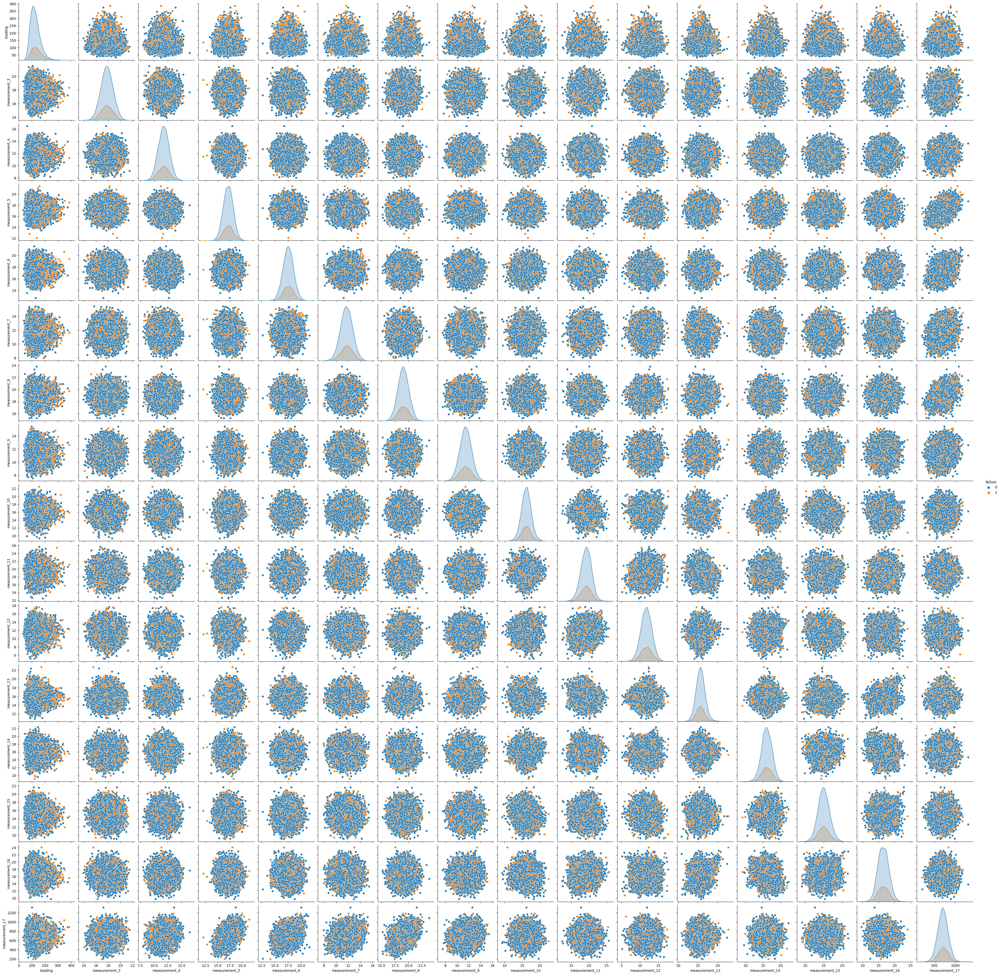

In [12]:
sns.pairplot(data=df_train, vars=continuous_cols, hue='failure')

c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\RAYHAN EGAR\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values

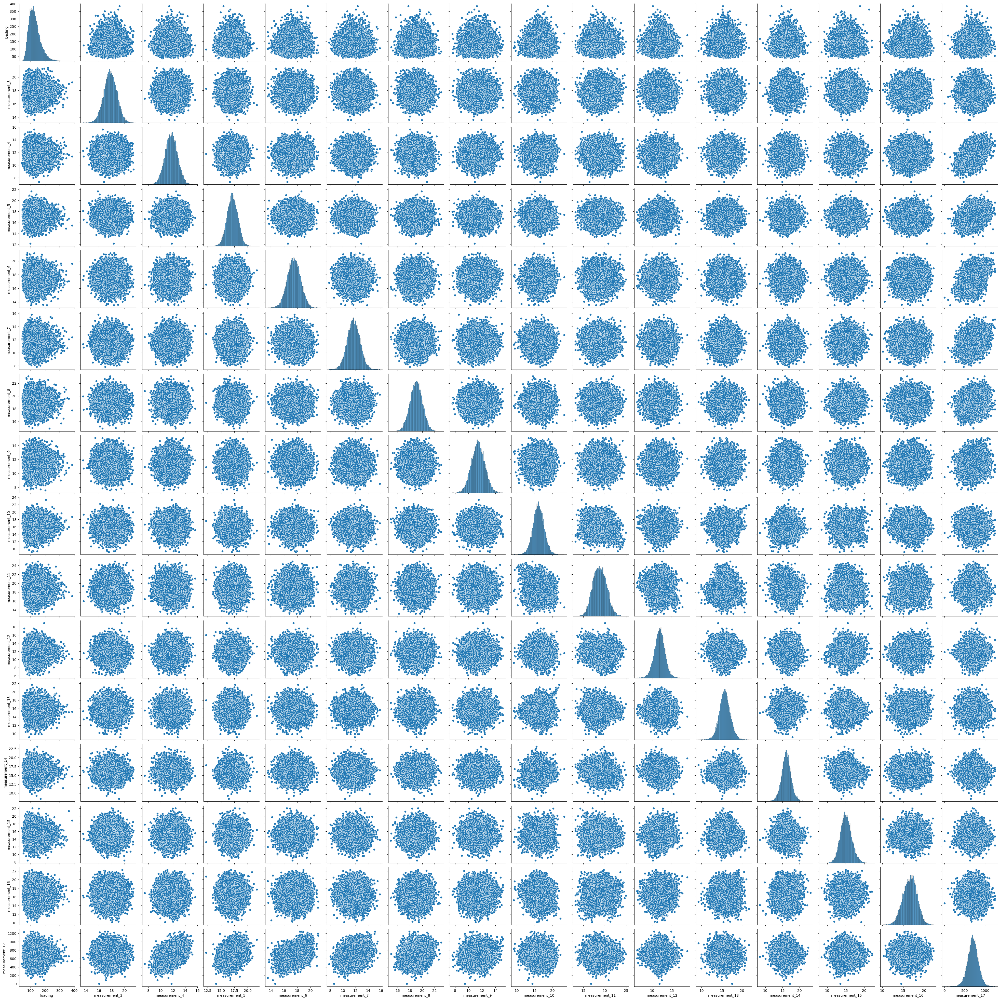

In [36]:
sns.pairplot(data=df_test, vars=continuous_cols)

### Imputation: KNNImputer
As there's no linearity between continuous featrures, KNNImputer is going to be used as the imputation method for filling in missing-values.

In [14]:
knnimputer = KNNImputer(n_neighbors=5)
df_train[continuous_cols] = knnimputer.fit_transform(df_train[continuous_cols])

In [37]:
knnimputer2 = KNNImputer(n_neighbors=5)
df_test[continuous_cols] = knnimputer2.fit_transform(df_test[continuous_cols])

In [16]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26570 entries, 0 to 26569
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              26570 non-null  int64  
 1   product_code    26570 non-null  object 
 2   loading         26570 non-null  float64
 3   attribute_0     26570 non-null  object 
 4   attribute_1     26570 non-null  object 
 5   attribute_2     26570 non-null  int64  
 6   attribute_3     26570 non-null  int64  
 7   measurement_0   26570 non-null  int64  
 8   measurement_1   26570 non-null  int64  
 9   measurement_2   26570 non-null  int64  
 10  measurement_3   26570 non-null  float64
 11  measurement_4   26570 non-null  float64
 12  measurement_5   26570 non-null  float64
 13  measurement_6   26570 non-null  float64
 14  measurement_7   26570 non-null  float64
 15  measurement_8   26570 non-null  float64
 16  measurement_9   26570 non-null  float64
 17  measurement_10  26570 non-null 

In [38]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20775 entries, 0 to 20774
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              20775 non-null  int64  
 1   product_code    20775 non-null  object 
 2   loading         20775 non-null  float64
 3   attribute_0     20775 non-null  object 
 4   attribute_1     20775 non-null  object 
 5   attribute_2     20775 non-null  int64  
 6   attribute_3     20775 non-null  int64  
 7   measurement_0   20775 non-null  int64  
 8   measurement_1   20775 non-null  int64  
 9   measurement_2   20775 non-null  int64  
 10  measurement_3   20775 non-null  float64
 11  measurement_4   20775 non-null  float64
 12  measurement_5   20775 non-null  float64
 13  measurement_6   20775 non-null  float64
 14  measurement_7   20775 non-null  float64
 15  measurement_8   20775 non-null  float64
 16  measurement_9   20775 non-null  float64
 17  measurement_10  20775 non-null 

### Further Analysis

<Axes: xlabel='failure', ylabel='count'>

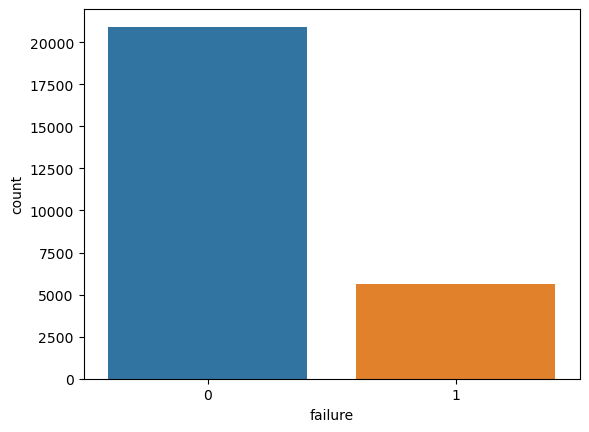

In [17]:
sns.countplot(data=df_train, x='failure')

#### Boxplot

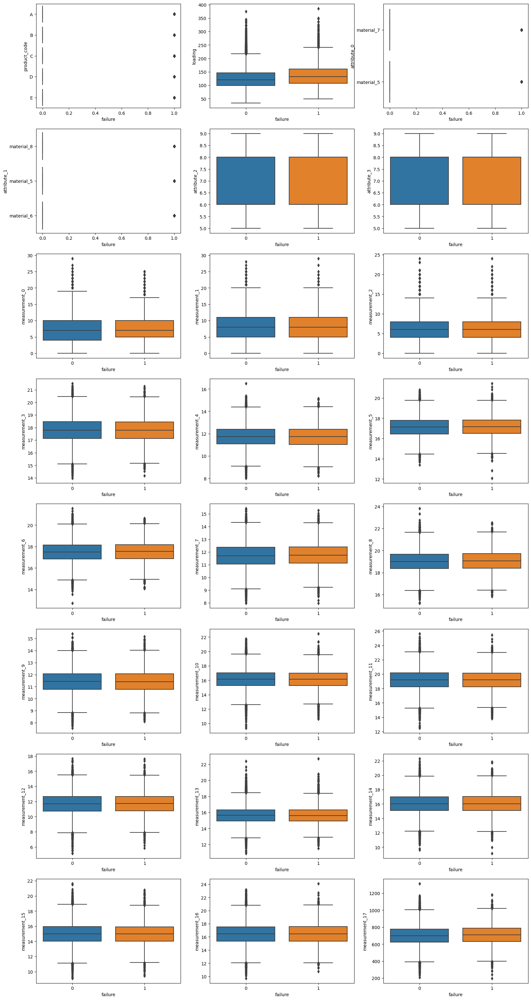

In [18]:
plt.figure(figsize=[20, 40])

for i, col in enumerate(df_train.columns[1:-1]):
    plt.subplot(8, 3, i+1)
    sns.boxplot(data=df_train, x='failure', y=col)

There is no evident difference between most of the measurements regarding failure, except for loading, while categorical values show that indeed the failure could be related to outliers.

#### Heatmap

<Axes: >

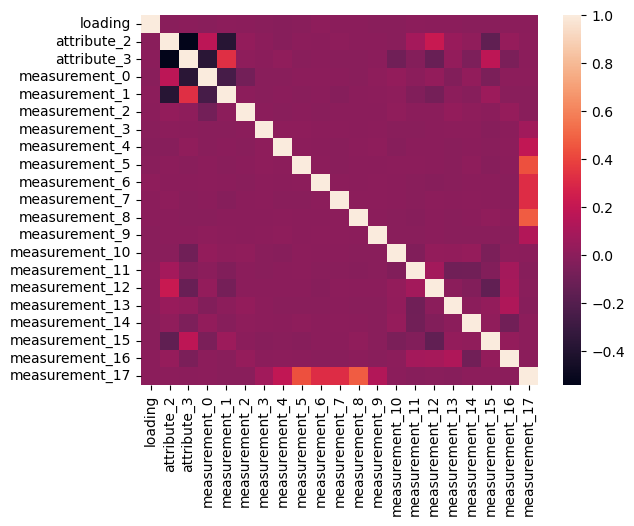

In [20]:
sns.heatmap(df_train[df_train.select_dtypes(include=['int64', 'float64']).columns[1:-1]].corr())

#### Feature drop
Removing columns of type 'object' and those that is destructive to the model training (based on heatmap)

In [23]:

total_cols=list(df_train.columns)
total_cols.remove("id")
total_cols.remove("product_code")
total_cols.remove("attribute_0")
total_cols.remove("attribute_1")
total_cols.remove("attribute_2")
total_cols.remove("attribute_3")
total_cols.remove("measurement_0")
total_cols.remove("measurement_1")

In [25]:
print(total_cols)
print(len(total_cols))

['loading', 'measurement_2', 'measurement_3', 'measurement_4', 'measurement_5', 'measurement_6', 'measurement_7', 'measurement_8', 'measurement_9', 'measurement_10', 'measurement_11', 'measurement_12', 'measurement_13', 'measurement_14', 'measurement_15', 'measurement_16', 'measurement_17', 'failure']
18


## Data Transformation
Encoding: One-Hot, to be safe.

In [42]:
df_train_oh = pd.get_dummies(df_train[total_cols], drop_first=True)
df_train_oh.head()

,loading,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
0,80.10,4,18.040,12.518,15.748,19.292,11.739,20.155,10.672,15.859,17.5940,15.193,15.029,15.489,13.034,14.684,764.100,0
1,84.89,3,18.213,11.540,17.717,17.893,12.748,17.889,12.448,17.947,17.9150,11.755,14.732,15.425,14.395,15.631,682.057,0
2,82.43,5,18.057,11.652,16.738,18.240,12.718,18.288,12.715,15.607,19.3088,13.798,16.711,18.631,14.094,17.946,663.376,0
3,101.07,6,17.295,11.188,18.576,18.339,12.583,19.060,12.471,16.346,18.3770,10.020,15.250,15.562,16.154,17.172,826.282,0
4,188.06,8,19.346,12.950,16.990,15.746,11.306,18.093,10.337,17.082,19.9320,12.428,16.182,12.760,13.153,16.412,579.885,0


In [43]:
df_test_oh = pd.get_dummies(df_test[total_cols[:-1]], drop_first=True)
df_test_id = pd.concat([df_test[['id']], df_test_oh], axis=1)
df_test_id.head()

,id,loading,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17
0,26570,119.57,6,19.305,10.178,17.534,18.168,11.598,18.654,10.802,15.909,18.0700,13.772,13.659,16.825,13.742,17.710,634.612
1,26571,113.51,0,17.883,11.927,17.228,16.033,11.179,19.368,12.032,13.998,19.2294,12.473,17.468,16.708,14.776,14.102,537.037
2,26572,112.16,4,18.475,10.481,16.619,18.189,12.126,17.774,11.743,17.046,18.0860,10.907,13.363,15.737,17.065,16.021,658.995
3,26573,112.72,10,16.518,10.888,15.293,18.592,11.304,18.948,11.790,18.165,16.1630,10.933,15.501,15.667,12.620,16.111,594.301
4,26574,208.00,8,17.808,12.693,17.678,15.814,13.431,19.141,12.370,14.578,17.8490,11.941,16.070,16.183,13.324,17.150,801.044


## Export

In [44]:
df_train_oh.to_csv('kid_train_clean_kaggle.csv')
df_test_id.to_csv('kid_test_clean_kaggle.csv')